<a href="https://colab.research.google.com/github/yewentao256/CS5787-Final/blob/main/inpainting_diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import zipfile
import os

zip_path = '/content/drive/MyDrive/scenery6000.zip'
extract_path = '/content/scenery6000'

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Files extracted to: {extract_path}")

Files extracted to: /content/scenery6000


In [ ]:
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torch import nn
from torchvision import transforms
import random
import numpy as np
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt
import os

In [ ]:
class SceneryDataset(Dataset):
    def __init__(self, root_dir, image_size=(320, 512), mask_type='vertical', mask_size=128, blur=50, num_masks=25, transform=None):
        self.root_dir = root_dir
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith('.jpg')]
        self.image_size = image_size
        self.mask_type = mask_type
        if mask_type == 'vertical':
            if not isinstance(mask_size, int):
                raise ValueError("mask_size must be an integer for 'vertical' mask type")
        elif mask_type == 'random':
            if not (isinstance(mask_size, tuple) and len(mask_size) == 2):
                raise ValueError("mask_size must be a tuple of two integers for 'random' mask type")
        self.mask_size = mask_size
        self.transform = transform if transform else transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ])
        self.blur = blur
        self.num_masks = num_masks
        self.masks = self.precompute_masks()

    def __len__(self):
        return len(self.image_files) * self.num_masks


    def __getitem__(self, idx):
        image_idx = idx // self.num_masks
        mask_idx = idx % self.num_masks
        img_path = os.path.join(self.root_dir, self.image_files[image_idx])
        image = Image.open(img_path).convert('RGB')
        image = self.transform(image)
        mask = self.masks[mask_idx]
        # Do not apply the mask here; return the original image and mask
        return image, mask


    def create_mask(self):
        if self.mask_type == 'vertical':
            return self.create_vertical_mask()
        elif self.mask_type == 'random':
            return self.create_random_mask()

    def precompute_masks(self):
        masks = []
        for _ in range(self.num_masks):
            mask = self.create_mask()
            masks.append(torch.tensor(mask))
        return torch.stack(masks)


    def gaussian_blur(self, mask):
        edges = np.abs(np.gradient(mask, axis=(0, 1))).sum(axis=0)
        edge_mask = (edges > 0).astype(np.float32)
        blurred_edges = gaussian_filter(edge_mask, sigma=self.blur)
        return np.clip(mask + blurred_edges, 0, 1)

    def create_vertical_mask(self):
        mask = np.ones(self.image_size, dtype=np.float32)
        if self.num_masks == 1:
            height, width = self.image_size
            left = width // 2 - self.mask_size // 2
        else:
            left = random.randint(0, self.image_size[1] - self.mask_size)
        right = left + self.mask_size
        mask[:, left:right] = 0
        blur = self.gaussian_blur(mask)
        return (blur - np.min(blur)) / (np.max(blur) - np.min(blur))

    def create_random_mask(self):
        mask = np.ones(self.image_size, dtype=np.float32)
        top = random.randint(0, self.image_size[0] - self.mask_size[0])
        left = random.randint(0, self.image_size[1] - self.mask_size[1])
        mask[top:top+self.mask_size[0], left:left+self.mask_size[1]] = 0
        blur = gaussian_filter(mask, sigma=self.blur)
        return (blur - np.min(blur)) / (np.max(blur) - np.min(blur))

    def show_img(self, idx):
        image, mask = self.__getitem__(idx)
        image = (image * 0.5 + 0.5).permute(1, 2, 0).numpy()

        plt.imshow(image)
        plt.show()
        plt.imshow(image * mask.unsqueeze(2).numpy())
        plt.show()

img_folder = '/content/scenery6000/scenery/all'
dataset = SceneryDataset(img_folder, num_masks=1)
dataloader = DataLoader(dataset, batch_size=16, shuffle=False)

In [ ]:
for batch_idx, (images, masks) in enumerate(dataloader):
    print(f"Batch {batch_idx + 1}")
    print("Images shape:", images.shape)  # [B, C, H, W]
    print("Masks shape:", masks.shape)    # [B, H, W]
    break

Batch 1
Images shape: torch.Size([16, 3, 320, 512])
Masks shape: torch.Size([16, 320, 512])


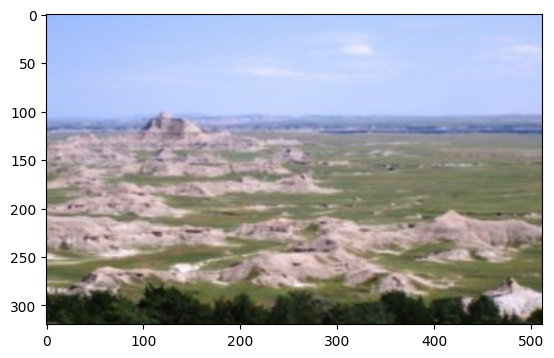

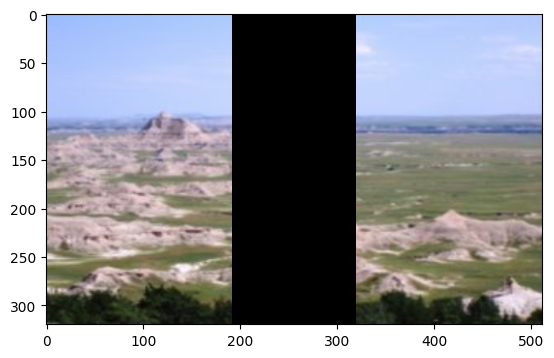

In [ ]:
dataset.show_img(500)

In [ ]:
class Block(nn.Module):
    def __init__(self, in_channels, out_channels, time_emb_dim):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.time_mlp = nn.Linear(time_emb_dim, out_channels)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)

    def forward(self, x, t_emb):
        # x: input feature map
        # t_emb: time embedding vector (batch_size, time_emb_dim)
        h = self.conv1(x)
        # Add time embedding
        time_emb = self.time_mlp(t_emb)
        time_emb = time_emb[:, :, None, None]  # Reshape to (batch_size, out_channels, 1, 1)
        h = h + time_emb
        h = self.bn1(h)
        h = self.relu(h)
        h = self.conv2(h)
        h = self.bn2(h)
        h = self.relu(h)
        return h

class Unet(nn.Module):
    def __init__(self, in_channels, out_channels, time_emb_dim=128, dims=[64, 128, 256, 512]):
        super().__init__()
        self.dims = dims
        self.encoders = nn.ModuleList()
        self.decoders = nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)
        in_ch = in_channels

        # Encoder blocks
        for dim in dims:
            self.encoders.append(Block(in_ch, dim, time_emb_dim))
            in_ch = dim

        # Bottleneck
        self.bottleneck = Block(dims[-1], dims[-1] * 2, time_emb_dim)

        # Decoder blocks
        prev_channels = dims[-1] * 2  # Starting from bottleneck's output channels
        for dim in reversed(dims):
            # Upsampling layer
            self.decoders.append(nn.ConvTranspose2d(prev_channels, dim, kernel_size=2, stride=2))
            # Decoder block
            self.decoders.append(Block(dim * 2, dim, time_emb_dim))
            prev_channels = dim  # Update for next iteration

        self.out_conv = nn.Conv2d(dims[0], out_channels, kernel_size=1)

    def forward(self, x, t_emb):
        skip_connections = []

        # Encoder path
        for encoder in self.encoders:
            x = encoder(x, t_emb)
            skip_connections.append(x)
            x = self.pool(x)

        # Bottleneck
        x = self.bottleneck(x, t_emb)
        skip_connections = skip_connections[::-1]

        # Decoder path
        for i in range(0, len(self.decoders), 2):
            # Upsampling
            x = self.decoders[i](x)  # ConvTranspose2d layer
            skip_connection = skip_connections[i // 2]

            # Ensure that the shapes match before concatenation
            if x.shape != skip_connection.shape:
                x = F.interpolate(x, size=skip_connection.shape[2:])

            # Concatenate with skip connection
            x = torch.cat((skip_connection, x), dim=1)

            # Decoder block with time embedding
            x = self.decoders[i + 1](x, t_emb)

        x = self.out_conv(x)
        return x

In [ ]:
import math
import time
class PositionalEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time_steps):
        device = time_steps.device
        half_dim = self.dim // 2
        emb = math.log(10000) / (half_dim - 1)
        emb = torch.exp(torch.arange(half_dim, device=device) * -emb)
        emb = time_steps[:, None] * emb[None, :]
        emb = torch.cat((torch.sin(emb), torch.cos(emb)), dim=-1)
        return emb

class Diffusion(nn.Module):
    def __init__(self, timesteps=1000, beta_start=1e-4, beta_end=0.02, device='cuda'):
        super().__init__()
        self.timesteps = timesteps
        self.unet = Unet(4, 3).to(device)
        self.device = device
        self.beta = torch.linspace(beta_start, beta_end, timesteps).to(device)
        self.alpha = 1 - self.beta
        self.alpha_bar = torch.cumprod(self.alpha, dim=0)
        self.time_embedding = PositionalEmbeddings(128)

    def add_noise(self, x, t):
        alpha_t = self.alpha_bar[t][:, None, None, None] #reshape to match x
        noise = torch.randn_like(x)
        x_t = torch.sqrt(alpha_t) * x + torch.sqrt(1 - alpha_t) * noise
        return x_t, noise

    def forward(self, x, mask, t):
        mask = mask.unsqueeze(1)
        t_embed = self.time_embedding(t)
        x = torch.cat([x, mask], dim=1)
        return self.unet(x, t_embed)

    def sample(self, x, mask):
        x_noise = torch.randn_like(x).to(self.device)
        mask = mask.unsqueeze(1)
        for t in range(self.timesteps - 1, -1, -1):
            t_tensor = torch.full((x.shape[0],), t, device=self.device, dtype=torch.long)
            # Enforce known regions
            x_noise = x_noise * (1 - mask) + x * mask
            pred = self.forward(x_noise, mask.squeeze(1), t_tensor)
            alpha_t = self.alpha[t].to(self.device)
            alpha_bar_t = self.alpha_bar[t].to(self.device)
            beta_t = self.beta[t].to(self.device)

            x_noise = (1 / torch.sqrt(alpha_t)) * (x_noise - beta_t / torch.sqrt(1 - alpha_bar_t) * pred)

            if t > 0:
                noise = torch.randn_like(x_noise).to(self.device)
                x_noise += torch.sqrt(beta_t) * noise

        # Final enforcement of known regions
        x_noise = x_noise * (1 - mask) + x * mask
        return x_noise

In [ ]:
def train_model(model, dataloader, optimizer, loss_fn, device, num_epochs):
    model.train()
    min_loss = 100
    increased = 0
    start = time.time()
    for epoch in range(num_epochs):
        for batch_idx, (images, masks) in enumerate(dataloader):
            optimizer.zero_grad()
            images, masks = images.to(device), masks.to(device)
            t = torch.randint(0, model.timesteps, (images.size(0),), device=device)

            # Add noise only to masked regions
            x_noisy, noise = model.add_noise(images, t)
            masks_unsqueezed = masks.unsqueeze(1)
            x_t = images * masks_unsqueezed + x_noisy * (1 - masks_unsqueezed)

            # Model prediction
            outputs = model(x_t, masks, t)

            # Compute loss only over masked regions
            loss = loss_fn(outputs * (1 - masks_unsqueezed), noise * (1 - masks_unsqueezed))
            loss.backward()
            optimizer.step()

            if batch_idx % 50 == 0:
                end = time.time()
                print(f"Epoch [{epoch + 1}/{num_epochs}], Batch [{batch_idx + 1}/{len(dataloader)}], Loss: {loss.item():.4f}, Time: {end - start: .4f}")
                if loss.item() < min_loss:
                    min_loss = loss.item()
                    increased = 0
                else:
                    increased += 1

                if increased > 40:
                    print('Early stopping')
                    torch.save(model.state_dict(), f'/content/drive/MyDrive/diffusion_model_earlystop_{epoch}_{batch_idx}_{end}.pth')
                    return

                start = time.time()
        if (epoch + 1) % 5 == 0:
            torch.save(model.state_dict(), f'/content/drive/MyDrive/diffusion_model_{epoch}_{batch_idx}.pth')



        # print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {loss.item()}")


In [ ]:
model = Diffusion().to('cuda')
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
loss_fn = nn.MSELoss()
train_model(model, dataloader, optimizer, loss_fn, 'cuda', 20)

In [ ]:
torch.save(model.state_dict(), '/content/drive/MyDrive/diffusion_model.pth')

In [ ]:
# Load the model
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = Diffusion().to(device)
model.load_state_dict(torch.load('/content/drive/MyDrive/diffusion_model.pth', map_location=device))
model.eval()  # Set the model to evaluation mode
dataloader_pred = DataLoader(dataset, batch_size=4, shuffle=True)
print("Model loaded successfully.")

<ipython-input-29-f48a939c5af3>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/MyDrive/diffusion_model.pth', map_location=

Model loaded successfully.


In [ ]:
def generate_inpainted_images(
    model,
    original_images,
    masks,
    num_images=4,
    device='cuda',
    save_path=None
):
    """
    Generate inpainted images using different masks for each input image.
    """
    # Ensure the model is in evaluation mode
    model.eval()

    # Limit to num_images if more are provided
    original_images = original_images[:num_images]
    masks = masks[:num_images]

    # Ensure masks have the right shape
    if masks.dim() == 3:  # If masks are 3D (e.g., batch, H, W)
        masks = masks.unsqueeze(1)  # Add channel dimension

    # Convert masks to float if needed
    masks = masks.float()

    # Move inputs to the specified device
    original_images = original_images.to(device)
    masks = masks.to(device)

    # Disable gradient computation for inference
    generated_images = []
    with torch.no_grad():
        # Process each image with all masks
        for img, mask_set in zip(original_images, masks):
            for mask in mask_set:
                mask = mask.unsqueeze(0)  # Ensure mask has batch dimension
                gen_img = model.sample(img.unsqueeze(0), mask)
                generated_images.append(gen_img.squeeze(0))

    # Stack generated images into a single tensor
    generated_images = torch.stack(generated_images)

    # Denormalize images for visualization
    generated_images = generated_images * 0.5 + 0.5

    # Optional: Save generated images
    if save_path:
        os.makedirs(save_path, exist_ok=True)
        for i, img in enumerate(generated_images):
            # Convert tensor to PIL Image
            img_np = img.permute(1, 2, 0).cpu().numpy()
            img_pil = Image.fromarray((img_np * 255).astype(np.uint8))
            img_pil.save(os.path.join(save_path, f'inpainted_image_{i}.png'))

    return generated_images

def visualize_inpainting(
    model,
    dataloader,
    device='cuda',
    num_images=4,
    save_path=None
):
    """
    Visualize inpainting results using different masks for each image.
    """
    # Get a batch of data
    original_masked_images, masks = next(iter(dataloader))

    # Ensure masks have at least 3 dimensions ([batch_size, num_masks, H, W])
    if masks.dim() == 3:  # If [batch_size, H, W], add num_masks=1 dimension
        masks = masks.unsqueeze(1)

    # Generate inpainted images
    generated_images = generate_inpainted_images(
        model,
        original_masked_images,
        masks,
        num_images=num_images,
        device=device,
        save_path=save_path
    )

    # Optional visualization
    if save_path:
        plt.figure(figsize=(15, 10))
        mask_sets = masks.size(1)  # Number of masks per image

        for i in range(num_images):
            for j in range(mask_sets):
                idx = i * mask_sets + j

                # Original image
                plt.subplot(3, num_images * mask_sets, idx + 1)
                original_img = (original_masked_images[i] * 0.5 + 0.5).permute(1, 2, 0).numpy()
                plt.imshow(original_img)
                plt.title('Original Image')
                plt.axis('off')

                # Masked image
                mask = masks[i, j].numpy() if masks.dim() > 3 else masks[i].numpy()
                masked_img = original_img * mask[..., None]  # Expand mask for RGB
                plt.subplot(3, num_images * mask_sets, num_images * mask_sets + idx + 1)
                plt.imshow(masked_img)
                plt.title('Masked Image')
                plt.axis('off')

                # Generated (inpainted) image
                plt.subplot(3, num_images * mask_sets, 2 * num_images * mask_sets + idx + 1)
                gen_img = generated_images[idx].permute(1, 2, 0).cpu().numpy()
                plt.imshow(gen_img)
                plt.title('Inpainted Image')
                plt.axis('off')

        plt.tight_layout()
        if save_path:
            plt.savefig(os.path.join(save_path, 'inpainting_comparison.png'))
        plt.show()

    return original_masked_images, generated_images

In [ ]:
# for batch_idx, (images, masks) in enumerate(dataloader_pred):
#     print(f"Batch {batch_idx + 1}")
#     print("Images shape:", images.shape)  # [B, C, H, W]
#     print("Masks shape:", masks.shape)
#     break

In [ ]:
masks.unsqueeze(1).expand(-1, 3, -1, -1).shape

torch.Size([16, 3, 320, 512])

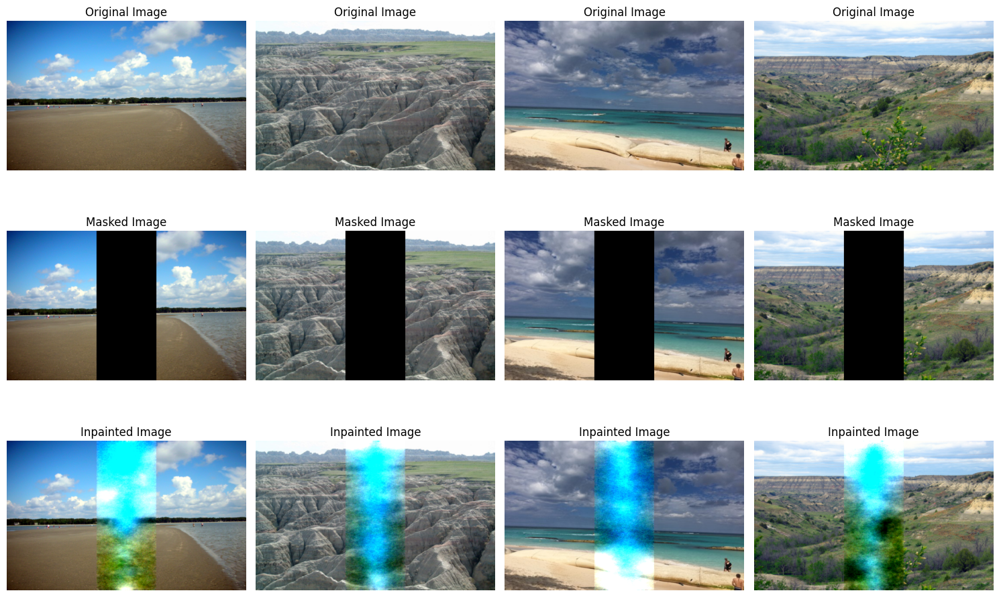

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        dataloader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


In [ ]:
img_folder = '/content/drive/MyDrive/scenery_test'
dataset_test = SceneryDataset(img_folder, num_masks=1)
dataloader_test = DataLoader(dataset_test, batch_size=4, shuffle=False)

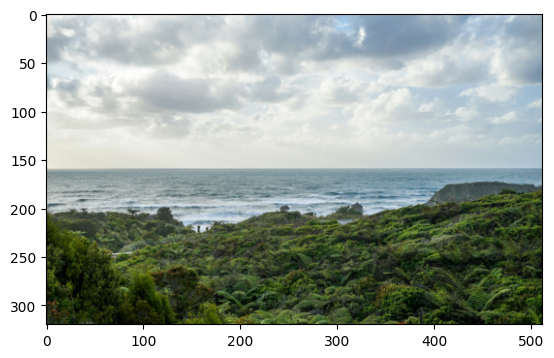

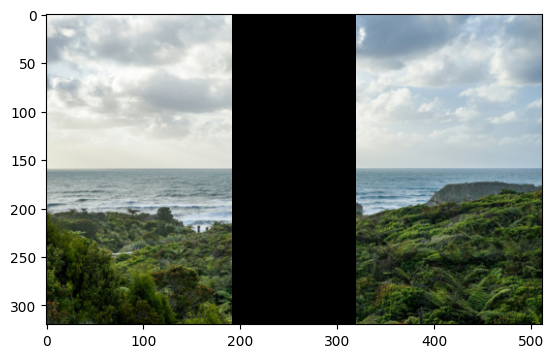

In [ ]:
dataset_test.show_img(1)

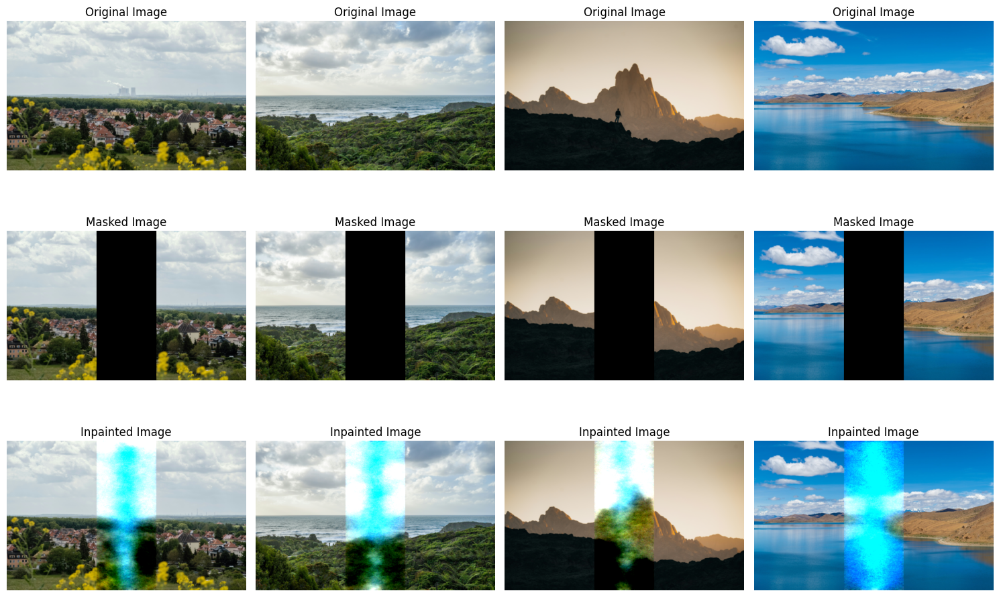

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/drive/MyDrive/scenery_test'

original_masked, generated = visualize_inpainting(
        model,
        dataloader_test,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


## Variable Placement for masks

In [ ]:
from torch.utils.data import random_split
dataset_4masks = SceneryDataset(img_folder, num_masks=4)
train_samples = int(len(dataset_4masks) * 0.8)
test_samples = len(dataset_4masks) - train_samples
train_dataset, test_dataset = random_split(dataset_4masks, [train_samples, test_samples])
print(f'Train: {len(train_dataset)}, Test: {len(test_dataset)}')

Train: 18560, Test: 4640


In [ ]:
gen = torch.Generator().manual_seed(123)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True, generator=gen)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
model = Diffusion().to('cuda')
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
loss_fn = nn.MSELoss()
train_model(model, train_loader, optimizer, loss_fn, 'cuda', 20)

Epoch [1/20], Batch [1/580], Loss: 0.3199, Time:  3.7691
Epoch [1/20], Batch [51/580], Loss: 0.0571, Time:  41.7461
Epoch [1/20], Batch [101/580], Loss: 0.0379, Time:  44.7522
Epoch [1/20], Batch [151/580], Loss: 0.0321, Time:  41.6463
Epoch [1/20], Batch [201/580], Loss: 0.0240, Time:  38.5775
Epoch [1/20], Batch [251/580], Loss: 0.0268, Time:  42.4109
Epoch [1/20], Batch [301/580], Loss: 0.0205, Time:  39.0128
Epoch [1/20], Batch [351/580], Loss: 0.0172, Time:  39.0699
Epoch [1/20], Batch [401/580], Loss: 0.0166, Time:  37.1958
Epoch [1/20], Batch [451/580], Loss: 0.0158, Time:  39.0073
Epoch [1/20], Batch [501/580], Loss: 0.0239, Time:  39.1533
Epoch [1/20], Batch [551/580], Loss: 0.0105, Time:  37.3161
Epoch [2/20], Batch [1/580], Loss: 0.0298, Time:  19.6114
Epoch [2/20], Batch [51/580], Loss: 0.0068, Time:  40.7135
Epoch [2/20], Batch [101/580], Loss: 0.0161, Time:  40.7353
Epoch [2/20], Batch [151/580], Loss: 0.0139, Time:  40.5135
Epoch [2/20], Batch [201/580], Loss: 0.0079, Ti

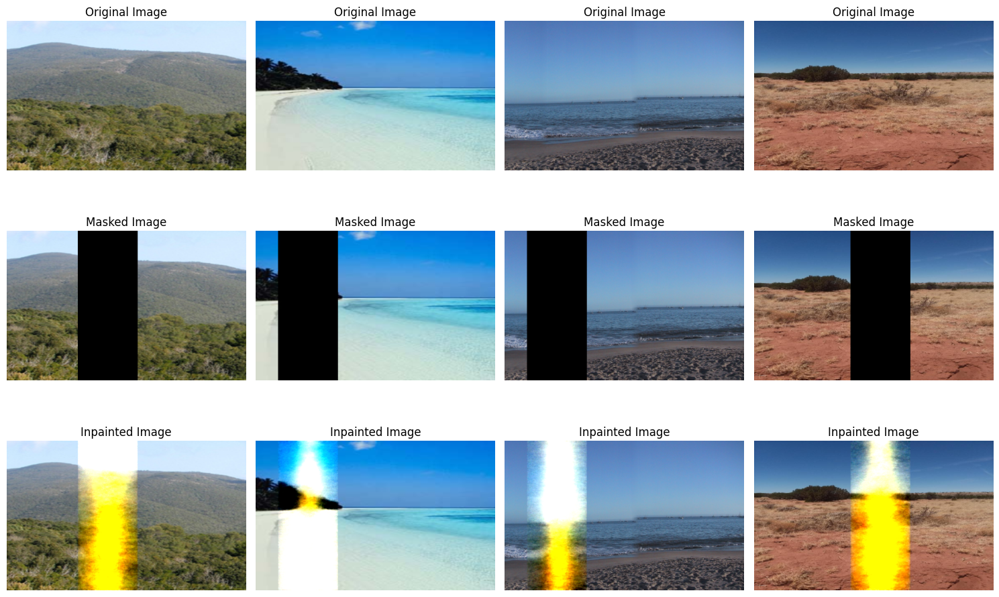

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_train'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        train_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


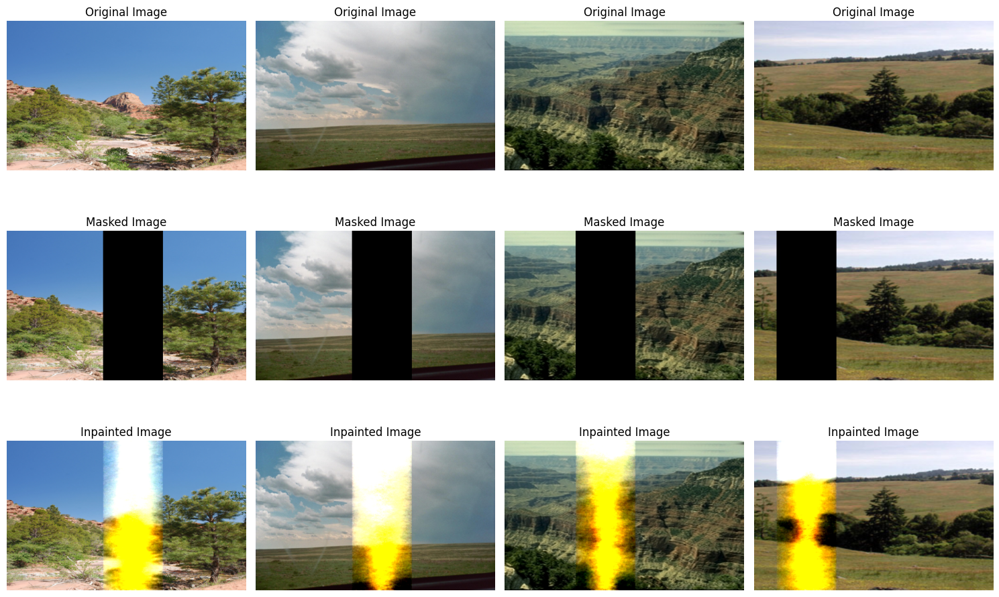

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        test_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )

In [ ]:
train_model(model, train_loader, optimizer, loss_fn, 'cuda', 20)

Epoch [1/20], Batch [1/580], Loss: 0.0039, Time:  0.5631
Epoch [1/20], Batch [51/580], Loss: 0.0065, Time:  37.5742
Epoch [1/20], Batch [101/580], Loss: 0.0049, Time:  39.5770
Epoch [1/20], Batch [151/580], Loss: 0.0065, Time:  41.8724
Epoch [1/20], Batch [201/580], Loss: 0.0060, Time:  41.6021
Epoch [1/20], Batch [251/580], Loss: 0.0061, Time:  39.5199
Epoch [1/20], Batch [301/580], Loss: 0.0054, Time:  40.6500
Epoch [1/20], Batch [351/580], Loss: 0.0039, Time:  39.1438
Epoch [1/20], Batch [401/580], Loss: 0.0049, Time:  39.2483
Epoch [1/20], Batch [451/580], Loss: 0.0065, Time:  40.1965
Epoch [1/20], Batch [501/580], Loss: 0.0055, Time:  37.6182
Epoch [1/20], Batch [551/580], Loss: 0.0066, Time:  40.4422
Early stopping


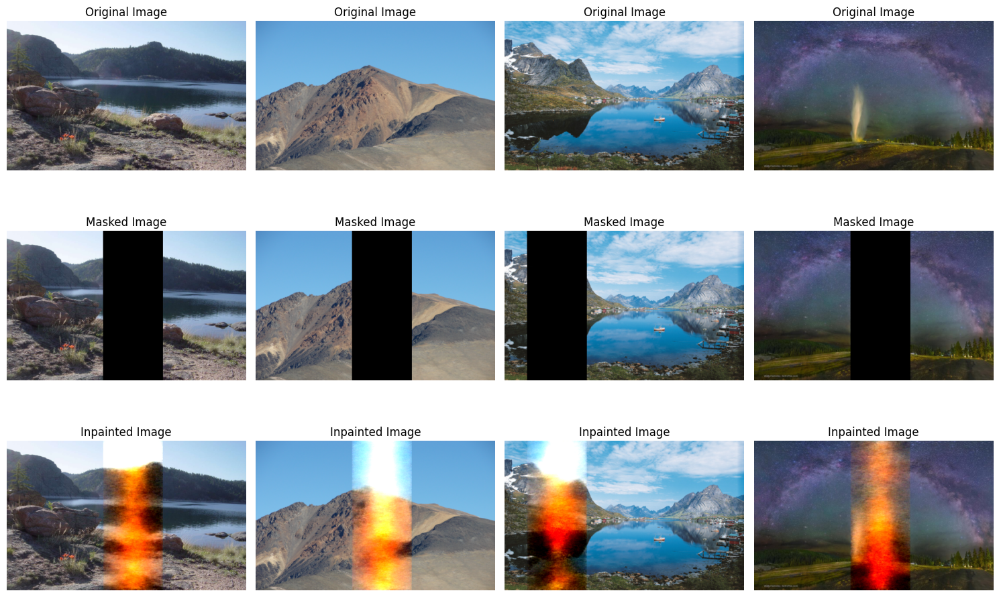

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_train'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        train_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


In [ ]:
train_model(model, train_loader, optimizer, loss_fn, 'cuda', 20)

Epoch [1/20], Batch [1/580], Loss: 0.0087, Time:  0.9410
Epoch [1/20], Batch [51/580], Loss: 0.0067, Time:  37.4644
Epoch [1/20], Batch [101/580], Loss: 0.0144, Time:  44.3456
Epoch [1/20], Batch [151/580], Loss: 0.0098, Time:  44.3743
Epoch [1/20], Batch [201/580], Loss: 0.0044, Time:  40.8724
Epoch [1/20], Batch [251/580], Loss: 0.0035, Time:  38.6595
Epoch [1/20], Batch [301/580], Loss: 0.0091, Time:  37.5999
Epoch [1/20], Batch [351/580], Loss: 0.0036, Time:  39.8045
Epoch [1/20], Batch [401/580], Loss: 0.0030, Time:  38.0443
Epoch [1/20], Batch [451/580], Loss: 0.0069, Time:  40.0117
Epoch [1/20], Batch [501/580], Loss: 0.0122, Time:  40.6381
Epoch [1/20], Batch [551/580], Loss: 0.0072, Time:  37.1727
Epoch [2/20], Batch [1/580], Loss: 0.0125, Time:  23.7187
Epoch [2/20], Batch [51/580], Loss: 0.0035, Time:  37.7615
Epoch [2/20], Batch [101/580], Loss: 0.0041, Time:  40.6345
Epoch [2/20], Batch [151/580], Loss: 0.0054, Time:  39.4133
Epoch [2/20], Batch [201/580], Loss: 0.0033, Ti

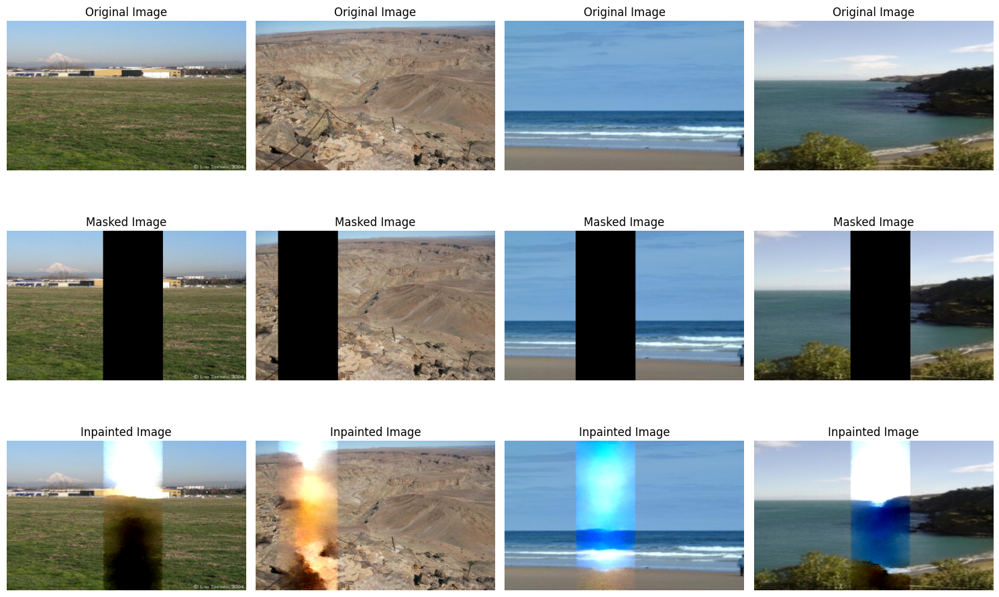

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_train'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        train_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


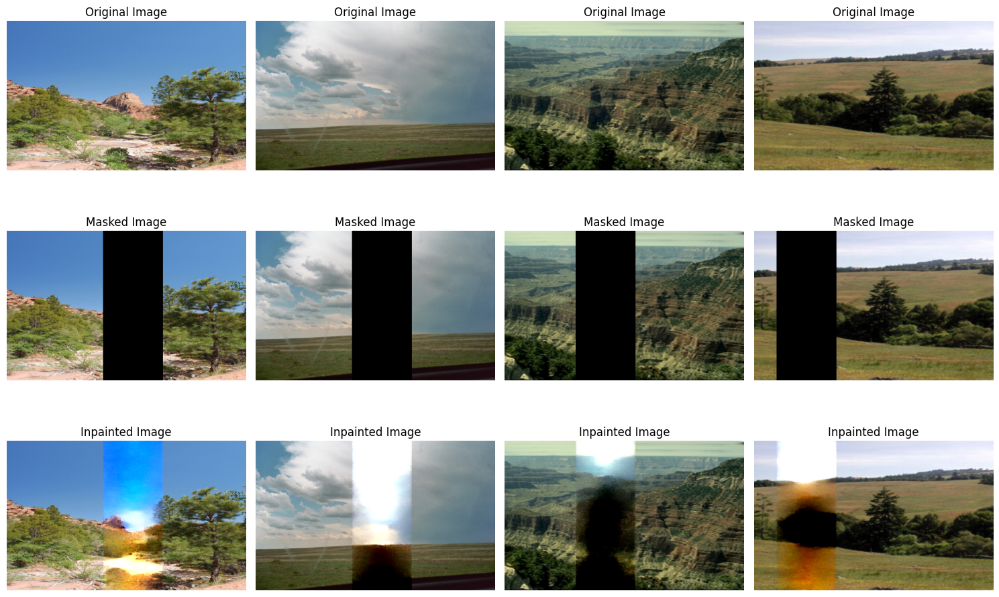

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        test_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )

In [ ]:
train_model(model, train_loader, optimizer, loss_fn, 'cuda', 20)

Epoch [1/20], Batch [1/580], Loss: 0.0040, Time:  1.0916
Epoch [1/20], Batch [51/580], Loss: 0.0027, Time:  36.6976
Epoch [1/20], Batch [101/580], Loss: 0.0056, Time:  42.0359
Epoch [1/20], Batch [151/580], Loss: 0.0046, Time:  38.4864
Epoch [1/20], Batch [201/580], Loss: 0.0019, Time:  40.1251
Epoch [1/20], Batch [251/580], Loss: 0.0033, Time:  39.7984
Epoch [1/20], Batch [301/580], Loss: 0.0043, Time:  36.8522
Epoch [1/20], Batch [351/580], Loss: 0.0062, Time:  40.7838
Epoch [1/20], Batch [401/580], Loss: 0.0026, Time:  41.1047
Epoch [1/20], Batch [451/580], Loss: 0.0042, Time:  37.4072
Epoch [1/20], Batch [501/580], Loss: 0.0020, Time:  37.5975
Epoch [1/20], Batch [551/580], Loss: 0.0016, Time:  38.4261
Epoch [2/20], Batch [1/580], Loss: 0.0071, Time:  23.4757
Epoch [2/20], Batch [51/580], Loss: 0.0030, Time:  39.6221
Epoch [2/20], Batch [101/580], Loss: 0.0026, Time:  41.9061
Epoch [2/20], Batch [151/580], Loss: 0.0057, Time:  36.4784
Epoch [2/20], Batch [201/580], Loss: 0.0054, Ti

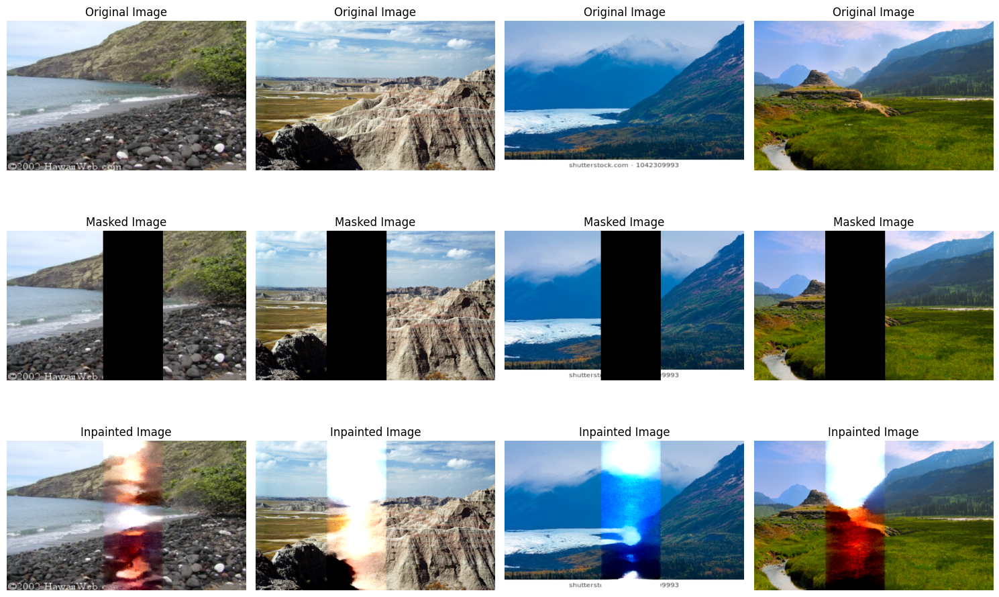

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_train'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        train_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )


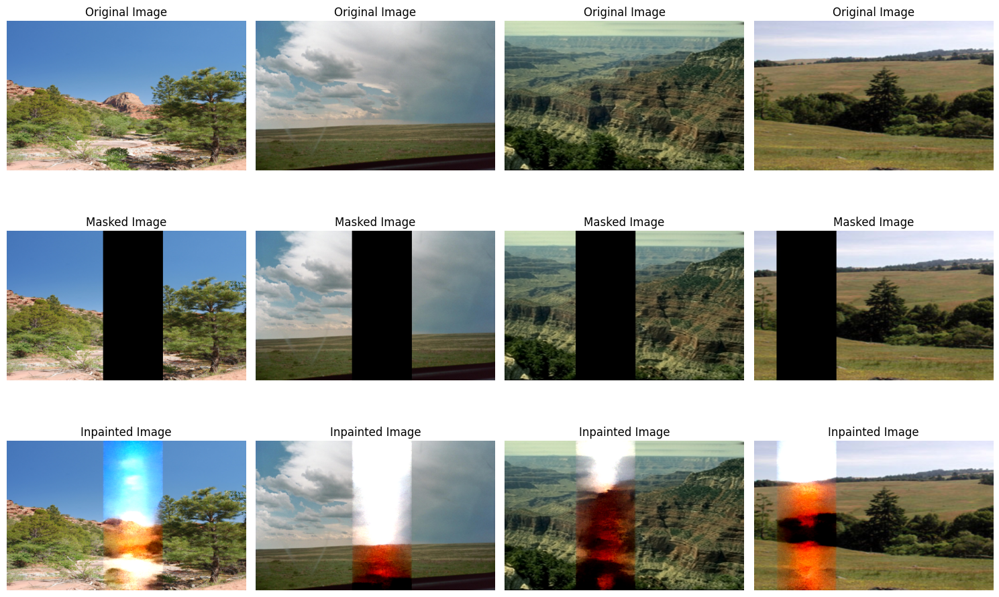

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        test_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )

In [ ]:
# Load the model
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = Diffusion().to(device)
model.load_state_dict(torch.load('/content/drive/MyDrive/diffusion_model_earlystop_3_50_1732571108.334945.pth', map_location=device))
model.eval()  # Set the model to evaluation mode
dataloader_pred = DataLoader(dataset, batch_size=4, shuffle=True)
print("Model loaded successfully.")

Model loaded successfully.


<ipython-input-12-f592ccad8f50>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/content/drive/MyDrive/diffusion_model_earlystop_3_50_1732

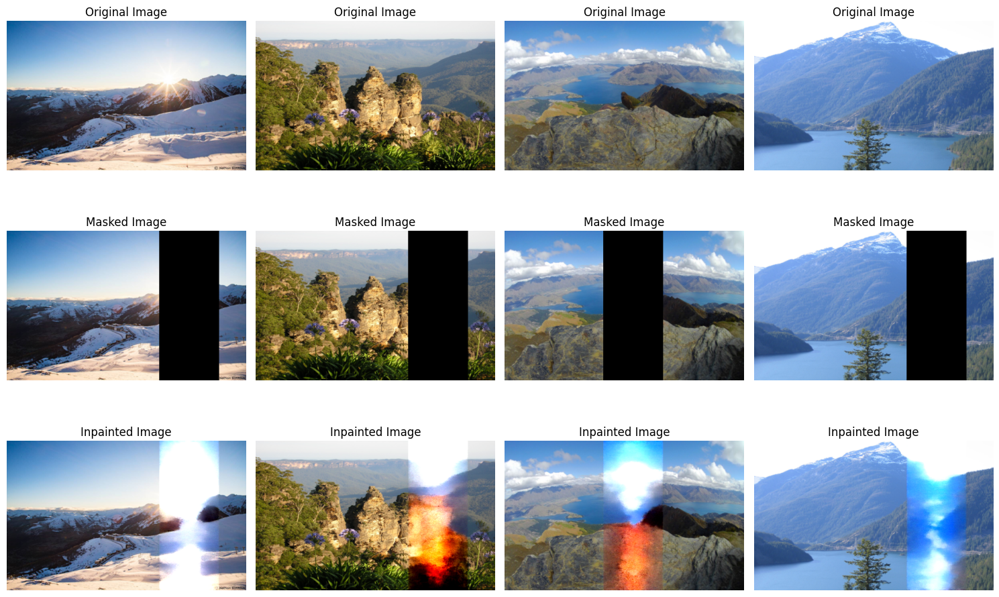

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        test_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )

In [ ]:
import torch
import torch.nn.functional as F
from torchvision.models import inception_v3
from torchvision.transforms import functional as TF
from sklearn.metrics import mean_squared_error
import numpy as np
from scipy.linalg import sqrtm
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from torch.utils.data import DataLoader

# Helper function for Inception Score
@torch.no_grad()
def calculate_inception_score(images, batch_size=32, device='cuda'):
    model = inception_v3(pretrained=True, transform_input=False).eval().to(device)
    images = F.interpolate(images, size=(299, 299), mode='bilinear', align_corners=False)
    images = (images + 1) / 2  # Normalize to [0, 1]

    preds = []
    for i in range(0, len(images), batch_size):
        batch = images[i:i+batch_size].to(device)
        preds.append(F.softmax(model(batch), dim=1).cpu().numpy())

    preds = np.concatenate(preds, axis=0)
    kl_div = preds * (np.log(preds) - np.log(preds.mean(axis=0, keepdims=True)))
    inception_score = np.exp(kl_div.sum(axis=1).mean())
    return inception_score

# Helper function for Fréchet Inception Distance
@torch.no_grad()
def calculate_fid(real_images, fake_images, batch_size=32, device='cuda'):
    model = inception_v3(pretrained=True, transform_input=False).eval().to(device)
    real_images = F.interpolate(real_images, size=(299, 299), mode='bilinear', align_corners=False)
    fake_images = F.interpolate(fake_images, size=(299, 299), mode='bilinear', align_corners=False)
    real_images = (real_images + 1) / 2  # Normalize to [0, 1]
    fake_images = (fake_images + 1) / 2

    def get_features(images):
        features = []
        for i in range(0, len(images), batch_size):
            batch = images[i:i+batch_size].to(device)
            features.append(model(batch).cpu().numpy())
        return np.concatenate(features, axis=0)

    real_features = get_features(real_images)
    fake_features = get_features(fake_images)

    mu_real, sigma_real = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
    mu_fake, sigma_fake = fake_features.mean(axis=0), np.cov(fake_features, rowvar=False)

    diff = mu_real - mu_fake
    covmean, _ = sqrtm(sigma_real.dot(sigma_fake), disp=False)
    fid = diff.dot(diff) + np.trace(sigma_real + sigma_fake - 2 * covmean)
    return fid

from skimage.metrics import structural_similarity

def evaluate_model(model, test_loader, device='cuda'):
    model.eval()
    mse_list, psnr_list, ssim_list = [], [], []
    real_images_list, fake_images_list = [], []

    for images, masks in test_loader:
        images, masks = images.to(device), masks.to(device)
        t = torch.randint(0, model.timesteps, (images.size(0),), device=device)
        x_noisy, _ = model.add_noise(images, t)

        masks_unsqueezed = masks.unsqueeze(1)
        x_t = images * masks_unsqueezed + x_noisy * (1 - masks_unsqueezed)

        with torch.no_grad():
            outputs = model(x_t, masks, t)

        # Remove noise from masked areas
        restored_images = x_t - outputs * (1 - masks_unsqueezed)

        real_images = images.cpu().numpy()
        fake_images = restored_images.cpu().numpy()

        for i in range(images.size(0)):
            real_img = real_images[i].transpose(1, 2, 0)
            fake_img = fake_images[i].transpose(1, 2, 0)

            mse_list.append(mean_squared_error(real_img.flatten(), fake_img.flatten()))
            psnr_list.append(peak_signal_noise_ratio(real_img, fake_img, data_range=2))

            # SSIM calculation with channel_axis specified
            ssim_list.append(
                structural_similarity(
                    real_img, fake_img, data_range=2, channel_axis=-1
                )
            )

            real_images_list.append(real_img)
            fake_images_list.append(fake_img)

    real_images_tensor = torch.tensor(np.array(real_images_list).transpose(0, 3, 1, 2))
    fake_images_tensor = torch.tensor(np.array(fake_images_list).transpose(0, 3, 1, 2))

    mse = np.mean(mse_list)
    psnr = np.mean(psnr_list)
    ssim = np.mean(ssim_list)
    fid = calculate_fid(real_images_tensor, fake_images_tensor, device=device)
    inception_score = calculate_inception_score(fake_images_tensor, device=device)

    return {
        'MSE': mse,
        'PSNR': psnr,
        'SSIM': ssim,
        'FID': fid,
        'Inception Score': inception_score
    }


In [ ]:
metrics = evaluate_model(model, test_loader, device='cuda')
metrics

{'MSE': 0.056639086,
 'PSNR': 19.380575858669758,
 'SSIM': 0.7617688,
 'FID': 505.60761678532526,
 'Inception Score': 3.4380033}

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
loss_fn = nn.MSELoss()
train_model(model, train_loader, optimizer, loss_fn, 'cuda', 20)

Epoch [1/20], Batch [1/580], Loss: 0.0063, Time:  1.9870
Epoch [1/20], Batch [51/580], Loss: 0.0027, Time:  40.1608
Epoch [1/20], Batch [101/580], Loss: 0.0036, Time:  39.5046
Epoch [1/20], Batch [151/580], Loss: 0.0014, Time:  40.5401
Epoch [1/20], Batch [201/580], Loss: 0.0038, Time:  40.0887
Epoch [1/20], Batch [251/580], Loss: 0.0017, Time:  42.8660
Epoch [1/20], Batch [301/580], Loss: 0.0021, Time:  39.4845
Epoch [1/20], Batch [351/580], Loss: 0.0064, Time:  41.3812
Epoch [1/20], Batch [401/580], Loss: 0.0031, Time:  40.5876
Epoch [1/20], Batch [451/580], Loss: 0.0020, Time:  43.6749
Epoch [1/20], Batch [501/580], Loss: 0.0043, Time:  42.5212
Epoch [1/20], Batch [551/580], Loss: 0.0038, Time:  37.1175
Epoch [2/20], Batch [1/580], Loss: 0.0031, Time:  22.4424
Epoch [2/20], Batch [51/580], Loss: 0.0018, Time:  39.6512
Epoch [2/20], Batch [101/580], Loss: 0.0019, Time:  39.5391
Epoch [2/20], Batch [151/580], Loss: 0.0067, Time:  43.1236
Epoch [2/20], Batch [201/580], Loss: 0.0019, Ti

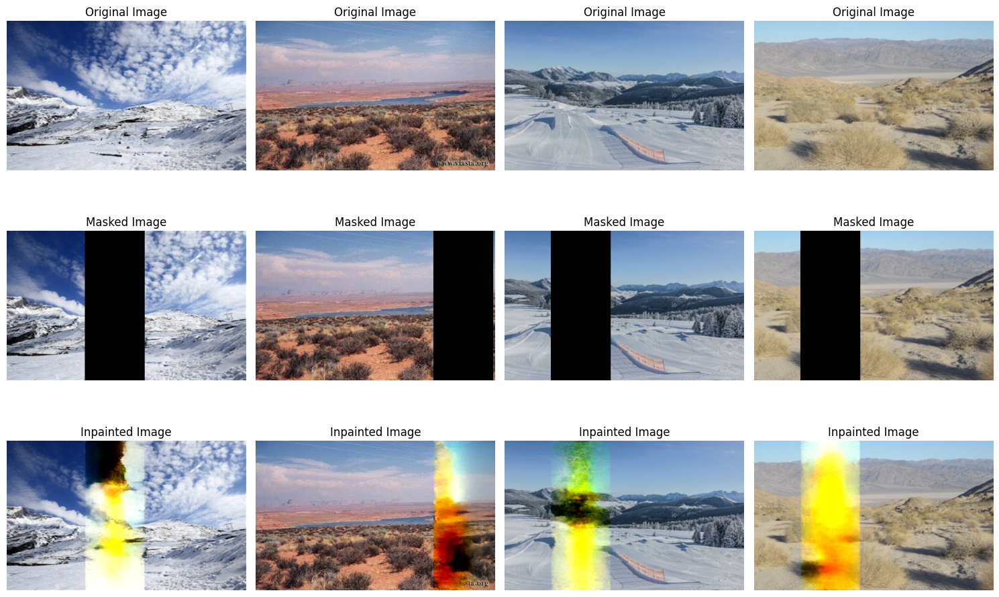

In [ ]:
# Set up directories
base_dir = '/content/drive/MyDrive/inpainting_results_rand_test'
os.makedirs(base_dir, exist_ok=True)

# Image folder (same as before)
img_folder = '/content/scenery6000/scenery/all'

original_masked, generated = visualize_inpainting(
        model,
        test_loader,
        device='cuda',
        num_images=4,
        save_path=base_dir
    )